## EDA

In [1]:
### KAGGLE CODE WRITTEN BY 'TARUN PAPARAJU' ###
import os
import gc
import re
# -----------
import cv2 # pip install opencv-python
import math
import numpy as np
import scipy as sp
import pandas as pd

In [2]:
import tensorflow as tf
from IPython.display import SVG
import efficientnet.tfkeras as efn # pip install efficientnet
from keras.utils import plot_model
import tensorflow.keras.layers as L
from keras.utils import model_to_dot
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model

In [3]:
#from kaggle_datasets import KaggleDatasets
from tensorflow.keras.applications import DenseNet121
import seaborn as sns
from tqdm import tqdm
import matplotlib.cm as cm
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

In [4]:
tqdm.pandas()
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
# --------------------
np.random.seed(0)
tf.random.set_seed(0)
# ---------------------
import warnings
warnings.filterwarnings("ignore")

In [5]:
EPOCHS = 20
SAMPLE_LEN = 100
IMAGE_PATH = "C:/Users/Administrator/kaggle/plant-pathology-2020-fgvc7/images/"
TEST_PATH = "C:/Users/Administrator/kaggle/plant-pathology-2020-fgvc7/test.csv"
TRAIN_PATH = "C:/Users/Administrator/kaggle/plant-pathology-2020-fgvc7/train.csv"
SUB_PATH = "C:/Users/Administrator/kaggle/plant-pathology-2020-fgvc7/sample_submission.csv"

In [6]:
sub = pd.read_csv(SUB_PATH)
test_data = pd.read_csv(TEST_PATH)
train_data = pd.read_csv(TRAIN_PATH)

In [7]:
def load_image(image_id):
    file_path = image_id + '.jpg'
    image = cv2.imread(IMAGE_PATH + file_path)
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [8]:
train_data.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [9]:
test_data.head()

,image_id
0,Test_0
1,Test_1
2,Test_2
3,Test_3
4,Test_4


In [10]:
train_images = train_data["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|██████████| 100/100 [00:01<00:00, 51.95it/s]



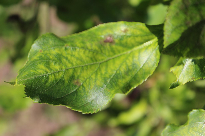

In [11]:
fig = px.imshow(cv2.resize(train_images[0], (205,136)))
fig.show()

In [12]:
train_images

0     [[[33, 51, 13], [33, 51, 13], [33, 51, 13], [3...
1     [[[203, 215, 215], [203, 215, 215], [204, 216,...
2     [[[120, 124, 109], [120, 124, 109], [121, 125,...
3     [[[103, 138, 70], [103, 138, 70], [103, 138, 7...
4     [[[77, 141, 47], [77, 141, 47], [76, 140, 46],...
                            ...                        
95    [[[110, 150, 115], [110, 150, 115], [110, 150,...
96    [[[27, 49, 28], [27, 49, 28], [27, 49, 28], [2...
97    [[[102, 133, 99], [102, 133, 99], [102, 133, 9...
98    [[[227, 228, 212], [228, 229, 213], [228, 230,...
99    [[[61, 83, 37], [61, 83, 37], [62, 84, 38], [6...
Name: image_id, Length: 100, dtype: object

In [13]:
train_images[0]

array([[[ 33,  51,  13],
        [ 33,  51,  13],
        [ 33,  51,  13],
        ...,
        [ 51,  61,  27],
        [ 51,  61,  27],
        [ 51,  61,  27]],

       [[ 33,  51,  13],
        [ 33,  51,  13],
        [ 33,  51,  13],
        ...,
        [ 50,  60,  26],
        [ 50,  60,  26],
        [ 50,  60,  26]],

       [[ 33,  51,  13],
        [ 33,  51,  13],
        [ 33,  51,  13],
        ...,
        [ 50,  60,  26],
        [ 50,  60,  26],
        [ 50,  60,  26]],

       ...,

       [[181, 167, 120],
        [182, 168, 121],
        [182, 168, 121],
        ...,
        [199, 206, 152],
        [197, 202, 148],
        [196, 201, 145]],

       [[181, 167, 120],
        [182, 168, 121],
        [182, 168, 121],
        ...,
        [199, 207, 156],
        [198, 205, 153],
        [202, 206, 155]],

       [[181, 167, 120],
        [182, 168, 121],
        [182, 168, 121],
        ...,
        [205, 213, 164],
        [206, 212, 164],
        [210, 216, 168]]

In [14]:
train_images[0][0]

array([[33, 51, 13],
       [33, 51, 13],
       [33, 51, 13],
       ...,
       [51, 61, 27],
       [51, 61, 27],
       [51, 61, 27]], dtype=uint8)

In [15]:
train_images[0][:,:,0]

array([[ 33,  33,  33, ...,  51,  51,  51],
       [ 33,  33,  33, ...,  50,  50,  50],
       [ 33,  33,  33, ...,  50,  50,  50],
       ...,
       [181, 182, 182, ..., 199, 197, 196],
       [181, 182, 182, ..., 199, 198, 202],
       [181, 182, 182, ..., 205, 206, 210]], dtype=uint8)

In [16]:
train_images[0][:,:,1]

array([[ 51,  51,  51, ...,  61,  61,  61],
       [ 51,  51,  51, ...,  60,  60,  60],
       [ 51,  51,  51, ...,  60,  60,  60],
       ...,
       [167, 168, 168, ..., 206, 202, 201],
       [167, 168, 168, ..., 207, 205, 206],
       [167, 168, 168, ..., 213, 212, 216]], dtype=uint8)

In [17]:
train_images[0][:,:,2]

array([[ 13,  13,  13, ...,  27,  27,  27],
       [ 13,  13,  13, ...,  26,  26,  26],
       [ 13,  13,  13, ...,  26,  26,  26],
       ...,
       [120, 121, 121, ..., 152, 148, 145],
       [120, 121, 121, ..., 156, 153, 155],
       [120, 121, 121, ..., 164, 164, 168]], dtype=uint8)

In [18]:
red_values = [np.mean(train_images[idx][:,:,0]) for idx in range(len(train_images))]
green_values = [np.mean(train_images[idx][:,:,1]) for idx in range(len(train_images))]
blue_values = [np.mean(train_images[idx][:,:,2]) for idx in range(len(train_images))]
# --------------------------------------------------------------------------------------
values = [np.mean(train_images[idx]) for idx in range(len(train_images))]

In [19]:
# # figure_factory
# fig = ff.create_distplot([values], group_labels = ['Channels'], colors = ['purple'])
# fig.update_layout(showlegend = False, template = 'simple_white')
# fig.update_layout(title_text = 'Distribution of channel values')
# fig

In [20]:
# ff : figure_factory
fig = ff.create_distplot([values], group_labels = ['Channels'], colors = ['purple'])
fig.update_layout(showlegend = False, template = 'simple_white')
fig.update_layout(title_text = 'Distribution of channel values')
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [21]:
train_data

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0
...,...,...,...,...,...
1816,Train_1816,0,0,0,1
1817,Train_1817,1,0,0,0
1818,Train_1818,1,0,0,0
1819,Train_1819,0,0,1,0


In [22]:
# ff : figure_factory
fig = ff.create_distplot([red_values], group_labels = ['R'], colors = ['red'])
fig.update_layout(showlegend = False, template = 'simple_white')
fig.update_layout(title_text = 'Distribution of red channel values')
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [23]:
# ff : figure_factory
fig = ff.create_distplot([green_values], group_labels = ['G'], colors = ['green'])
fig.update_layout(showlegend = False, template = 'simple_white')
fig.update_layout(title_text = 'Distribution of green channel values')
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [24]:
# ff : figure_factory
fig = ff.create_distplot([blue_values], group_labels = ['B'], colors = ['blue'])
fig.update_layout(showlegend = False, template = 'simple_white')
fig.update_layout(title_text = 'Distribution of blue channel values')
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

In [25]:
# go : graph_objects
fig = go.Figure()
for idx, values in enumerate([red_values,green_values,blue_values]):
    if idx == 0:
        color = 'Red'
    if idx == 1:
        color = 'Green'
    if idx == 2:
        color = 'Blue'
    fig.add_trace(go.Box(x = [color]*len(values), y = values, name = color, marker = dict(color=color.lower())))
# ---------------
fig.update_layout(yaxis_title = 'Mean value', xaxis_title = 'Color channel', title = 'Mean value vs. Color channel', template = 'plotly_white')

In [26]:
# ff : figure_factory
fig = ff.create_distplot([red_values,green_values,blue_values], group_labels = ['R','G','B'], colors = ['red', 'green', 'blue'])
fig.update_layout(title_text = 'Distribution of red channel values', template = 'simple_white')
# -----------------
fig.data[0].marker.line.color = 'rgb(0,0,0)'
fig.data[0].marker.line.width = 0.5
# ---
fig.data[1].marker.line.color = 'rgb(0,0,0)'
fig.data[1].marker.line.width = 0.5
# ---
fig.data[2].marker.line.color = 'rgb(0,0,0)'
fig.data[2].marker.line.width = 0.5
# ---
fig

In [27]:
train_data.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [28]:
train_data.healthy.value_counts()

healthy
0    1305
1     516
Name: count, dtype: int64

In [29]:
min([3, len(train_images)//3]) , len(train_images)//3

(3, 33)

In [30]:
len(train_images.index)

100

In [31]:
len(train_data)

1821

In [32]:
len(train_data.loc[:100])

101

In [33]:
# data = train_data.loc[:100]
# list(data.index)

In [34]:
def visualize_leaves(cond = [0,0,0,0], cond_cols = ['healthy'], is_cond = True):
    if not is_cond : 
        cols, rows = 3, min([3, len(train_images)//3])
        fig, ax = plt.subplots(nrows = rows, ncols = cols, figsize = (30, rows*20/3))
        for col in range(cols):
            for row in range(rows):
                ax[row, col].imshow(train_images.loc[train_images.index[-row*3-col-1]])
        return None
    # ---------------------------
    cond_0 = 'healthy == {}'.format(cond[0])
    cond_1 = 'scab == {}'.format(cond[1])
    cond_2 = 'rust == {}'.format(cond[2])
    cond_3 = 'multiple_diseases == {}'.format(cond[3])
    # ---------------------------------------------------
    
    cond_lst = []
    for col in cond_cols:
        if col == 'healthy':
            cond_lst.append(cond_0)
        if col == 'scab':
            cond_lst.append(cond_1)
        if col == 'rust':
            cond_lst.append(cond_2)
        if col == 'multiple_diseases':
            cond_lst.append(cond_3)
    # ------------------------------
    #data = train_data.loc[:100]
    data = train_data.loc[:99]
    for cond in cond_lst:
        data = data.query(cond)
    # ----------------------------------
    images = train_images.loc[list(data.index)]
    cols, rows = 3, min([3, len(images)//3])
    
    fig, ax = plt.subplots(nrows = rows, ncols = cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.loc[images.index[row*3+col]])
    plt.show()

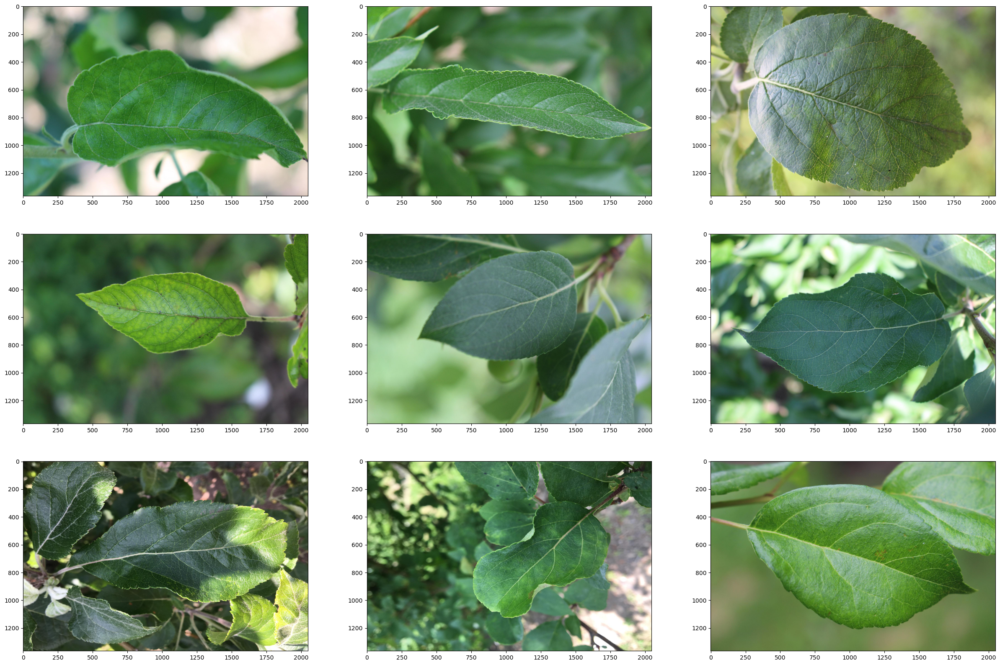

In [35]:
visualize_leaves(cond = [1,0,0,0], cond_cols=['healthy'])

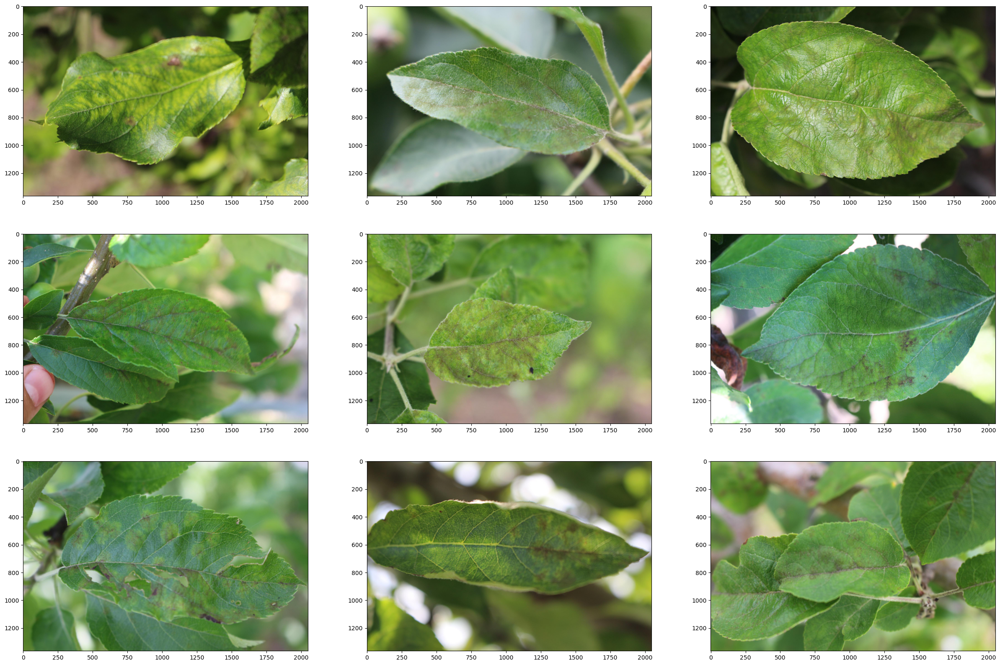

In [36]:
visualize_leaves(cond = [0,1,0,0], cond_cols=['scab'])

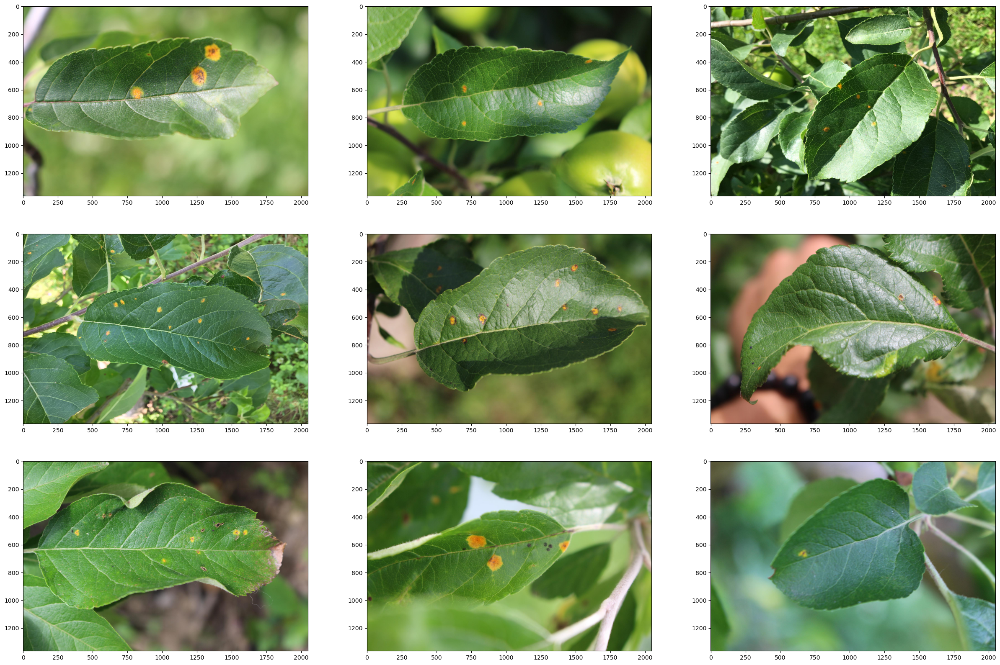

In [37]:
visualize_leaves(cond = [0,0,1,0], cond_cols=['rust'])

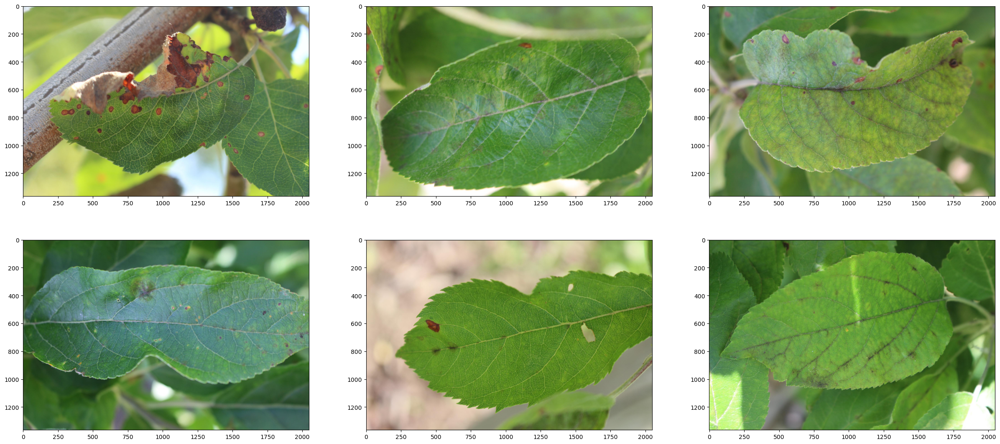

In [38]:
visualize_leaves(cond = [0,0,0,1], cond_cols=['multiple_diseases'])

In [39]:
pd.__version__

'2.0.3'

In [40]:
# iteritems is removed from pandas 2.0
pd.DataFrame.iteritems = pd.DataFrame.items

In [41]:
# import plotly.express as px
fig = px.parallel_categories(train_data[['healthy','scab','rust','multiple_diseases']], color = 'healthy', color_continuous_scale = 'sunset', title = 'Parallel categories plot of the targets')
fig

In [42]:
train_data.columns

Index(['image_id', 'healthy', 'multiple_diseases', 'rust', 'scab'], dtype='object')

In [43]:
cond_tst1 = (train_data['rust'] == 0)
cond_tst2 = (train_data['scab'] == 0)
cond_tst3 = (train_data['multiple_diseases'] == 1)
# -------------
train_data.loc[cond_tst1&cond_tst2&cond_tst3,'multiple_diseases']

1       1
6       1
25      1
36      1
62      1
       ..
1708    1
1779    1
1780    1
1784    1
1815    1
Name: multiple_diseases, Length: 91, dtype: int64

In [44]:
# go : graph_objects
fig = go.Figure([go.Pie(labels = train_data.columns[1:], values = train_data.iloc[:,1:].sum().values)])
fig.update_layout(title_text = 'Pie chart of the targets', template = 'simple_white')
# ---
fig.data[0].marker.line.color = 'rgb(0,0,0)'
fig.data[0].marker.line.width = 0.5
fig.show()

In [45]:
train_data['Healthy'] = train_data['healthy'].apply(bool).apply(str)
fig = px.histogram(train_data, x = 'Healthy', title = 'Healthy distribution', color = 'Healthy', color_discrete_map = {
    'True': px.colors.qualitative.Plotly[0], 'False': px.colors.qualitative.Plotly[1]
})
fig.update_layout(template = 'simple_white')
# ---
fig.data[0].marker.line.color = 'rgb(0,0,0)'
fig.data[0].marker.line.width = 0.5
# ---
fig.data[1].marker.line.color = 'rgb(0,0,0)'
fig.data[1].marker.line.width = 0.5
# -----------------------------------
fig

In [46]:
train_data["Scab"] = train_data["scab"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Scab", color="Scab", title="Scab distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

In [47]:
train_data["Rust"] = train_data["rust"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Rust", color="Rust", title="Rust distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

In [48]:
train_data["Multiple diseases"] = train_data["multiple_diseases"].apply(bool).apply(str)
fig = px.histogram(train_data, x="Multiple diseases", color="Multiple diseases", title="Multiple diseases distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[0]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

In [49]:
train_data

,image_id,healthy,multiple_diseases,rust,scab,Healthy,Scab,Rust,Multiple diseases
0,Train_0,0,0,0,1,False,True,False,False
1,Train_1,0,1,0,0,False,False,False,True
2,Train_2,1,0,0,0,True,False,False,False
3,Train_3,0,0,1,0,False,False,True,False
4,Train_4,1,0,0,0,True,False,False,False
...,...,...,...,...,...,...,...,...,...
1816,Train_1816,0,0,0,1,False,True,False,False
1817,Train_1817,1,0,0,0,True,False,False,False
1818,Train_1818,1,0,0,0,True,False,False,False
1819,Train_1819,0,0,1,0,False,False,True,False
